In [2]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as Dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle
from torch.utils.data import Subset
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [2]:
device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lr = 5e-5
batch_size = 64
image_size = 64
image_channels = 3
z_dim = 100
epochs = 50
disc_features = 64
gen_features = 64
CRITIC_ITERS = 5
WEIGHT_CLIP = 0.015

### Downloading Images

In [3]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])
train_Dataset = Dataset.CIFAR10('./data', download=True, train=True, transform=transform)
test_Dataset = Dataset.CIFAR10('./data', download=True, train=False, transform=transform)
train_Dataset=train_Dataset+test_Dataset
train_Dataloader = torch.utils.data.DataLoader(train_Dataset, shuffle=False, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


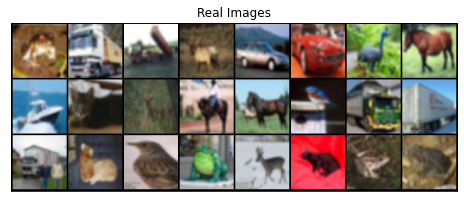

In [4]:
def display_images(images, title, figsize=(8,8), nrow=8):
    images = vutils.make_grid(images, nrow, normalize=True)
    images=images.numpy()
    plt.figure(figsize=figsize)
    plt.imshow(np.transpose(images, (1,2,0)))
    plt.xticks([])
    plt.yticks([])
    plt.title(title)
    plt.show()
    
images, labels = next(iter(train_Dataloader))
display_images(images[:24], 'Real Images')

### Generator Model

In [5]:
class Generator_Model(nn.Module):
    def __init__(self):
        super(Generator_Model, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, gen_features*8, 4, 1, 0),     
            self._block(gen_features*8, gen_features*4, 4, 2, 1), 
            self._block(gen_features*4, gen_features*2, 4, 2, 1), 
            self._block(gen_features*2, gen_features, 4, 2, 1), 
            nn.ConvTranspose2d(gen_features, image_channels, 4, 2, 1),
            nn.Tanh()
        
        )
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.ConvTranspose2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.ReLU(True)
                            )
    
    def forward(self, z):
        return self.net(z)
    

### Discriminator Model

In [6]:
class Discriminator_Model(nn.Module):
    def __init__(self):
        super(Discriminator_Model, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(image_channels, disc_features, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),                         
            self._block(disc_features, disc_features*2, 4, 2, 1),   
            self._block(disc_features*2, disc_features*4, 4, 2, 1), 
            self._block(disc_features*4, disc_features*8, 4, 2, 1),  
            nn.Conv2d(disc_features*8, 1, 4, 1, 0, bias=False), 
        )
        
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.LeakyReLU(0.2, inplace=True),
                            )
    
    def forward(self, x):
        return self.net(x)

In [7]:
def initialize_weights(M):
    classname = M.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(M.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(M.weight.data, 0.0, 0.02)
        nn.init.constant_(M.bias.data, 0)
        
Critic_Model = Discriminator_Model().to(device)
Gen_Model = Generator_Model().to(device)
Critic_Model.apply(initialize_weights)
Gen_Model.apply(initialize_weights)
fixed_noise = torch.randn(32, z_dim, 1, 1).to(device)
Critic_optimizer = optim.RMSprop(Critic_Model.parameters(), lr=lr)
Gen_optimizer = optim.RMSprop(Gen_Model.parameters(), lr=lr)

[10/50]   Loss_D:-3.2078847885131836   Loss_G:1.507175326347351


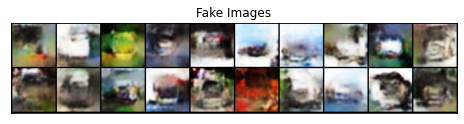

[20/50]   Loss_D:-3.4545812606811523   Loss_G:1.6189271211624146


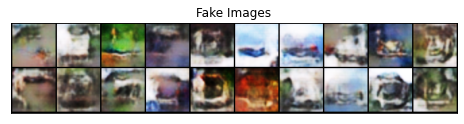

[30/50]   Loss_D:-3.3991870880126953   Loss_G:1.5885963439941406


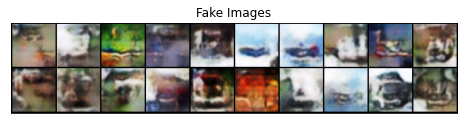

[40/50]   Loss_D:-0.23295950889587402   Loss_G:0.5101597905158997


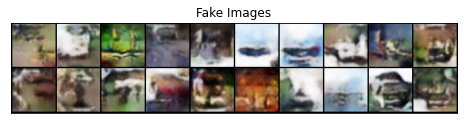

[50/50]   Loss_D:-3.125706672668457   Loss_G:1.4850373268127441


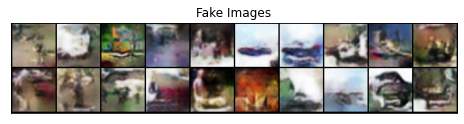

In [9]:
img_list = []
GEN_LOSS = []
CRITIC_LOSS = []
FID_score = []

for epoch in range(1,epochs+1):
    Gen_Model.train()
    Critic_Model.train()
    for i, (real, _) in enumerate(train_Dataloader):
        real = real.to(device)
        
        
        ### TRAIN DISCRIMINATOR 
        for _ in range(CRITIC_ITERS):
            mb_size = real.size(0)
            
            Critic_Model.zero_grad()    
            noise = torch.randn(mb_size, z_dim, 1, 1).to(device)
            fake = Gen_Model(noise)
            
            #TRAIN WITH REAL IMAGES
            
            Critic_real = Critic_Model(real).view(-1)
            
            #TRAIN WITH FAKE IMAGES
            
            Critic_fake = Critic_Model(fake).view(-1)
            critic_loss = -(torch.mean(Critic_real) - torch.mean(Critic_fake))
            critic_loss.backward(retain_graph=True)
            Critic_optimizer.step()
            for p in Critic_Model.parameters():
                p.data.clamp_(-WEIGHT_CLIP, WEIGHT_CLIP)
        
        ### TRAIN GENERATOR
        
        Gen_Model.zero_grad()
        output = Critic_Model(fake).view(-1)
        
        #CALCULATE GENERATOR'S PARAMETERS
        
        lossGen = -torch.mean(output)
        lossGen.backward()
        Gen_optimizer.step()
        GEN_LOSS.append(lossGen.item())
        CRITIC_LOSS.append(critic_loss.item())
        
    with torch.no_grad():
        Gen_Model.eval()
        fakes = Gen_Model(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fakes, padding=2, normalize=True, nrow=6))
    vutils.save_image(fakes[:10].cpu(),'IMAGE_DATA/wganimage10.png', nrow=10)
    
    vutils.save_image(real.cpu(),'IMAGE_DATA/WGAN_IMAGES/real/image{}.png'.format(epoch), nrow=10, normalize=True)
    vutils.save_image(fakes.cpu(),'IMAGE_DATA/WGAN_IMAGES/fake/image{}.png'.format(epoch), nrow=10, normalize=True)

    
    if epoch%10 == 0:
        print(f'[{epoch}/{epochs}]   Loss_D:{critic_loss.item()}   Loss_G:{lossGen.item()}')
        display_images(fakes[:20].cpu(), 'Fake Images', figsize=(8,8), nrow=10)


vutils.save_image(fakes[:10].cpu(),'IMAGE_DATA/wganimage10.png', nrow=10)
vutils.save_image(fakes[:24].cpu(),'IMAGE_DATA/wganimage.png')
vutils.save_image(fakes[:10].cpu(),'IMAGE_DATA/wganimage10norm.png', nrow=10, normalize=True)
vutils.save_image(fakes[:24].cpu(),'IMAGE_DATA/wganimagenorm.png', normalize=True)


torch.save(Gen_Model,'Models/wgan.pth')  


losses = {'GenLoss': GEN_LOSS,
         'CriticLoss': CRITIC_LOSS}
with open('pickle/wgan_loss.txt', 'wb') as f:
    pickle.dump(losses,f)

#SAVING GENERATED IMAGES FOR VISUALIZATION
with open('pickle/wganImg.txt', 'wb') as f:
    pickle.dump(img_list,f)

### Plotting the Loss

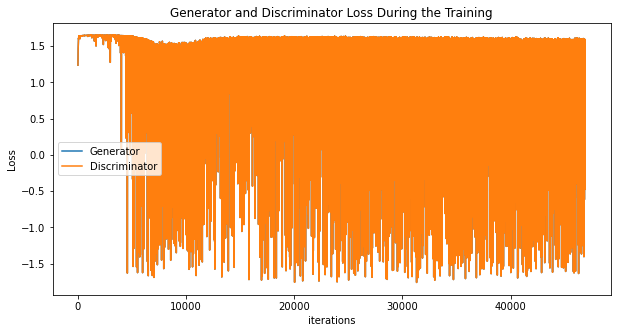

In [10]:
import pickle
import matplotlib.pyplot as plt
with open('pickle/wgan_loss.txt', 'rb') as f:
    loss = pickle.load(f)
    
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During the Training")
plt.plot(loss['GenLoss'],label="Generator")
plt.plot(loss['GenLoss'],label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Computing the FID Scores

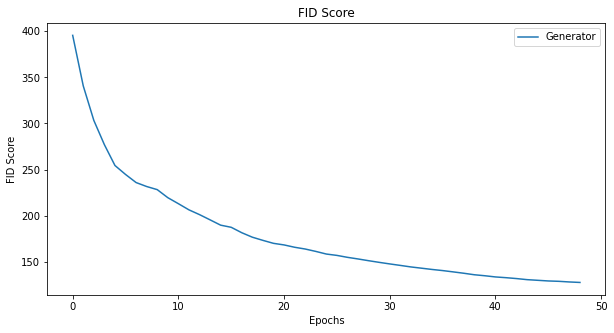

In [3]:
from FID import fidScore
WGAN_FID = []
for k in range(1,50):
    k = k+1
    fids = fidScore('IMAGE_DATA/WGAN_IMAGES/real', 'IMAGE_DATA/WGAN_IMAGES/fake',k,64)
    print(f'Epoch:{k} and FID Score: {fids}', end = '\r', flush=True)
    WGAN_FID.append(fids)
    

#save fid score list to file
with open('pickle/wganfid.txt', 'wb') as f:
    pickle.dump(WGAN_FID,f)
    
plt.figure(figsize=(10,5))
plt.title("FID Score")
plt.plot(WGAN_FID,label="Generator")
plt.xlabel("Epochs")
plt.ylabel("FID Score")
plt.legend()
plt.show()

### Visualizing animation of the images generated at every epoch

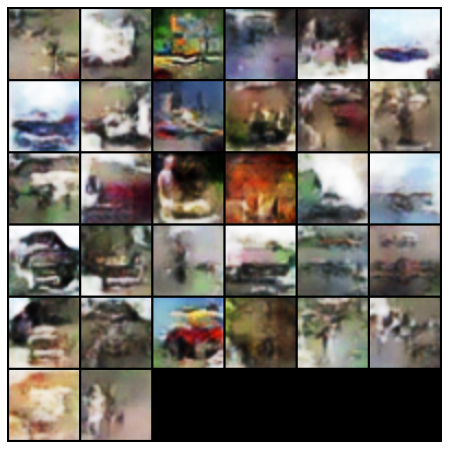

In [4]:
with open('pickle/wganImg.txt', 'rb') as f:
    image_list = pickle.load(f)

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in image_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())